In [101]:
import numpy as np
from keras.models import Sequential, load_model
from keras.layers import Dense, LSTM, Dropout, Activation
from sklearn.preprocessing import MinMaxScaler
import os
import matplotlib.pyplot as plt
import sys
from keras.utils.vis_utils import plot_model
from IPython.display import SVG
import time
from keras.callbacks import Callback, ModelCheckpoint

In [35]:
timesteps = seq_length = 10
data_dim = 50

In [123]:
xy = np.loadtxt('./data/health_161.csv', delimiter=',',skiprows=1)

numpy.ndarray

In [124]:
x = xy[:,8:xy.shape[1]]
y = xy[:, 0]

In [125]:
scaler = MinMaxScaler(feature_range=(0, 1))
x = scaler.fit_transform(x)
y = y/100

In [129]:
dataX = []
dataY = []
for i in range(0, len(y) - seq_length):
    _x = x[i:i + seq_length]
    _y = y[i + seq_length]  # Next close price
    print(_x, "->", _y)
    dataX.append(_x)
    dataY.append(_y)

[[1.00000000e+00 6.74955595e-02 4.98399001e-04 2.73861773e-03
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.18976400e-03
  0.00000000e+00 1.53672400e-03 9.31755082e-02 3.89337736e-03
  2.78153945e-01 0.00000000e+00 1.65696408e-03 0.00000000e+00
  2.47595427e-02 1.81201761e-02 8.61008610e-03 3.27330936e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 9.55737395e-03
  1.52997334e-03 9.97427828e-01 3.55258908e-03 0.00000000e+00
  1.80327869e-01 1.42857143e-01 0.00000000e+00 0.00000000e+00
  1.67182720e-05 9.93518185e-01 1.58730159e-02 2.35294118e-01
  1.16101759e-02 0.00000000e+00 1.87468799e-03 1.88696039e-01
  8.21602171e-01 1.09050198e-03 5.88562453e-01 6.41414482e-04
  1.21857165e-02 1.68878166e-02]
 [1.00000000e+00 0.00000000e+00 8.85007572e-05 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 4.60792973e-03
  0.00000000e+00 1.53672400e-03 9.31755082e-02 2.32367680e-03
  8.50434992e-01 0.00000000e+00 1.324

  7.71247879e-03 4.46320869e-02]] -> 0.96
[[1.00000000e+00 0.00000000e+00 3.32709614e-05 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.46877137e-03
  0.00000000e+00 2.59206458e-04 8.94348042e-02 3.89337736e-03
  8.77940970e-01 0.00000000e+00 1.72237283e-04 0.00000000e+00
  3.07183521e-03 1.71793450e-02 0.00000000e+00 8.87785812e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 2.28398722e-03
  2.56430457e-04 9.97528416e-01 8.93529982e-03 6.08006318e-03
  1.47540984e-01 1.42857143e-01 0.00000000e+00 0.00000000e+00
  1.11603952e-06 9.85956068e-01 1.58730159e-02 5.88235294e-02
  3.03464935e-03 0.00000000e+00 6.49163801e-04 1.45082332e-01
  7.96811710e-01 5.83851733e-04 7.56246895e-01 4.73110885e-04
  5.86148388e-03 3.25693607e-02]
 [1.00000000e+00 0.00000000e+00 3.32709614e-05 1.42837709e-03
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.46877137e-03
  0.00000000e+00 2.59206458e-04 8.94348042e-02 6.70453881

  3.85623940e-03 2.77442702e-02]] -> 0.9125
[[1.00000000e+00 7.28241563e-02 2.16640538e-02 0.00000000e+00
  0.00000000e+00 1.00000000e+00 0.00000000e+00 2.22953837e-04
  1.24678462e-01 1.77000981e-02 1.78210213e-02 4.59535525e-03
  9.83002150e-01 0.00000000e+00 2.48460219e-01 0.00000000e+00
  6.73116082e-02 3.02800761e-01 1.47601476e-02 9.90062212e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.01756591e-03
  1.77000891e-02 9.65685218e-01 1.07654215e-02 4.94793817e-01
  1.47540984e-01 2.85714286e-01 0.00000000e+00 0.00000000e+00
  1.25905440e-01 1.00000000e+00 3.17460317e-02 1.17647059e-01
  3.58873707e-02 8.48896435e-04 1.43873419e-04 1.59768580e-01
  7.67625363e-01 4.85881148e-04 3.20879614e-01 8.91423674e-02
  3.47061546e-02 2.41254524e-02]
 [1.00000000e+00 7.28241563e-02 1.86563589e-02 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 2.22953837e-04
  0.00000000e+00 1.77000981e-02 1.62171542e-02 3.623635

  7.63535400e-02 3.03980700e-01]] -> 0.85
[[1.00000000e+00 7.10479574e-02 8.28047687e-03 7.89112115e-01
  0.00000000e+00 1.00000000e+00 0.00000000e+00 8.50507304e-02
  2.22134282e-02 5.01657070e-02 1.19286068e-02 7.20967040e-01
  1.99614233e-01 0.00000000e+00 2.21253977e-01 0.00000000e+00
  1.43564394e-01 1.00905272e-01 1.79581796e-02 6.96857074e-04
  0.00000000e+00 3.23331717e-01 0.00000000e+00 0.00000000e+00
  0.00000000e+00 4.54545455e-01 0.00000000e+00 9.81136059e-02
  5.01599265e-02 9.99065971e-01 7.10517817e-03 2.80708505e-01
  2.95081967e-01 2.85714286e-01 4.16666667e-01 0.00000000e+00
  2.77759915e-04 9.12855600e-01 0.00000000e+00 5.88235294e-02
  1.45104552e-01 8.48896435e-04 9.57252260e-02 3.48019582e-01
  6.70763855e-01 5.53407208e-02 1.96775176e-01 3.32139859e-02
  4.13388863e-02 2.65379976e-02]
 [1.00000000e+00 7.10479574e-02 3.61928172e-02 4.95482176e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.37190955e-02
  2.22134282e-02 6.34963248e-02 7.41670798e-02 4.59155287

  1.26484652e-01 3.49819059e-02]] -> 0.83
[[1.00000000e+00 7.10479574e-02 5.77078171e-02 9.02276096e-02
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.93962363e-02
  6.75303387e-02 3.80015182e-02 1.78507685e-02 9.13708718e-02
  2.94749955e-01 0.00000000e+00 5.11689700e-02 0.00000000e+00
  1.50871316e-01 8.35324549e-02 2.31242312e-02 1.06922114e-01
  0.00000000e+00 0.00000000e+00 1.90438795e-01 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 2.66527935e-02
  3.80012348e-02 9.93935997e-01 8.93529982e-03 1.53244738e-01
  2.13114754e-01 1.42857143e-01 8.33333333e-01 0.00000000e+00
  6.89315558e-02 1.00000000e+00 1.58730159e-02 5.88235294e-02
  3.12795350e-01 5.65930956e-04 1.80084452e-02 2.46550957e-01
  4.95041590e-01 8.76869840e-03 2.33863859e-01 2.08432409e-02
  8.37575197e-02 3.13630881e-02]
 [1.00000000e+00 7.10479574e-02 5.79739848e-02 1.00587818e-01
  0.00000000e+00 1.00000000e+00 0.00000000e+00 2.07737816e-02
  5.70137053e-02 4.83420044e-02 1.10121468e-01 9.82899039

  6.63273176e-03 2.65379976e-02]] -> 0.95
[[1.00000000e+00 0.00000000e+00 4.45830882e-05 1.42837709e-03
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.91615791e-03
  0.00000000e+00 4.25839181e-04 1.39167080e-02 4.27036548e-03
  3.54825099e-02 0.00000000e+00 8.61186415e-05 0.00000000e+00
  6.62462299e-03 1.28098800e-02 7.62607626e-03 1.70588592e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 4.42164630e-03
  4.23989708e-04 9.99612019e-01 5.38271073e-03 5.08753978e-03
  1.63934426e-02 1.42857143e-01 0.00000000e+00 0.00000000e+00
  1.49549295e-06 1.00000000e+00 1.58730159e-02 5.88235294e-02
  4.92186910e-03 0.00000000e+00 8.51106612e-04 1.46862483e-02
  9.98533432e-01 5.30149951e-04 9.10051129e-01 2.30019283e-04
  8.94647540e-03 2.65379976e-02]
 [1.00000000e+00 0.00000000e+00 1.13121269e-05 1.42837709e-03
  0.00000000e+00 0.00000000e+00 0.00000000e+00 7.91425950e-03
  0.00000000e+00 1.63855511e-03 1.39167080e-02 9.12083769

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.895
[[1.00000000e+00 3.73001776e-02 1.43730553e-04 1.18136451e-04
  1.53846154e-01 0.00000000e+00 0.00000000e+00 1.10143779e-02
  9.60576263e-02 2.52726296e-03 8.54586019e-02 2.51230086e-01
  9.79626690e-01 0.00000000e+00 2.61289826e-04 0.00000000e+00
  2.01130145e-02 4.20187861e-02 0.00000000e+00 9.96939889e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 2.96488134e-02
  2.52514569e-03 9.99511431e-01 5.38271073e-03 8.03125065e-04
  9.83606557e-02 0.00000000e+00 0.00000000e+00 0.00000000e+00
  9.60677665e-02 1.00000000e+00 1.58730159e-02 5.88235294e-02
  5.93341889e-03 2.82965478e-04 6.86588224e-02 8.72274143e-02
  7.24836696e-01 7.26686890e-03 6.00599445e-01 6.98645614e-03
  6.47848218e-03 3.01568154e-02]
 [1.00000000e+00 4.61811723e-02 1.43730553e-04 6.55120320e-04
  1.53846154e-01 0.00000000e+00 0.00000000e+00 7.80627014e-03
  0.00000000e+00 1.28677492e-03 8.34705007e-02 2.52432548e-01
  8.09628097e-01 0.00000000

  1.24942156e-02 2.05066345e-02]] -> 0.96
[[1.00000000e+00 0.00000000e+00 8.36897762e-03 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 8.37764690e-03
  0.00000000e+00 3.33265446e-03 1.19286068e-02 1.03967475e-01
  9.88768560e-01 0.00000000e+00 6.13183711e-02 0.00000000e+00
  2.99871586e-02 8.59264694e-02 5.90405904e-03 9.95637069e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 9.09090909e-02 0.00000000e+00 1.77236550e-02
  3.32943010e-03 9.96436321e-01 3.17041662e-01 4.64034527e-03
  4.09836066e-01 1.42857143e-01 0.00000000e+00 0.00000000e+00
  2.80728580e-04 1.00000000e+00 1.58730159e-02 1.17647059e-01
  4.26058730e-02 5.65930956e-04 2.24910556e-03 4.05874499e-01
  6.59549002e-01 4.30449986e-03 7.87501402e-01 1.65466691e-03
  8.02097794e-03 2.77442702e-02]
 [1.00000000e+00 0.00000000e+00 8.68970969e-03 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 7.97952828e-03
  1.28538004e-01 3.33265446e-03 1.19286068e-02 6.93235663

  9.91824772e-02 2.77442702e-02]] -> 0.87
[[1.00000000e+00 7.10479574e-02 4.08440976e-02 7.73256771e-04
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.45438976e-03
  7.05359648e-02 2.92255281e-02 1.69905801e-02 3.24339783e-03
  8.13606317e-01 0.00000000e+00 2.02270080e-02 0.00000000e+00
  6.52115869e-02 8.05770502e-02 5.73185732e-02 7.70057364e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 9.09478191e-03
  2.92241849e-02 8.45109281e-01 3.55258908e-03 1.85804289e-01
  4.91803279e-01 4.28571429e-01 8.33333333e-01 0.00000000e+00
  9.67272565e-02 9.91357580e-01 3.17460317e-02 1.76470588e-01
  1.46493546e-01 1.13186191e-03 1.22552418e-03 4.92656876e-01
  5.95933296e-01 6.89848626e-04 1.50342197e-01 2.00079365e-02
  1.40984112e-01 3.01568154e-02]
 [1.00000000e+00 6.92717584e-02 2.57903184e-02 7.73256771e-04
  1.53846154e-01 1.00000000e+00 0.00000000e+00 6.33839301e-03
  1.74991371e-01 3.01790376e-02 1.70748637e-02 3.89012746

[[1.00000000e+00 7.28241563e-02 3.84066670e-02 4.11687633e-03
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.12063620e-03
  2.74433301e-02 2.47634741e-02 7.95240456e-03 1.34220772e-01
  5.41741175e-01 0.00000000e+00 4.60710743e-01 0.00000000e+00
  7.98192253e-02 3.04838916e-01 1.45141451e-02 6.80536479e-01
  0.00000000e+00 4.19191850e-01 7.85314617e-04 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 7.57423739e-03
  2.47625727e-02 9.50180339e-01 3.95306276e-01 5.25855161e-01
  3.60655738e-01 2.85714286e-01 0.00000000e+00 0.00000000e+00
  3.46023588e-03 1.00000000e+00 1.58730159e-02 2.35294118e-01
  2.25862459e-02 8.48896435e-04 1.05218272e-03 3.48019582e-01
  6.05756627e-01 4.45095927e-03 3.05765255e-01 8.68591411e-02
  1.97439457e-02 2.65379976e-02]
 [1.00000000e+00 7.28241563e-02 2.36163938e-02 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 3.09147426e-04
  2.15782588e-03 1.78389587e-02 7.95240456e-03 3.46114097e-03
  3.78513592e-01 0.00000000e+00 4.448

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[1.00000000e+00 6.74955595e-02 4.56144880e-03 6.08581718e-05
  3.07692308e-01 0.00000000e+00 0.00000000e+00 1.61916352e-04
  1.45714853e-01 2.22176964e-04 1.19286068e-02 2.86640971e-03
  9.43380684e-01 0.00000000e+00 4.59069311e-05 0.00000000e+00
  3.84915101e-04 7.80319025e-04 7.38007380e-03 9.31142442e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 6.83547537e-04
  2.15605247e-04 6.40901841e-01 7.10517817e-03 4.15694212e-04
  3.77049180e-01 0.00000000e+00 8.33333333e-02 0.00000000e+00
  1.96644667e-01 1.00000000e+00 3.17460317e-02 0.00000000e+00
  4.87657583e-03 0.00000000e+00 2.30544154e-04 3.48019582e-01
  5.97427847e-01 2.57586514e-04 2.60470260e-01 6.12940029e-05
  8.17522752e-03 4.17370326e-01]
 [1.00000000e+00 0.00000000e+00 4.23985169e-02 6.08581718e-05
  3.07692308e-01 0.00000000e+00 0.00000000e+00 1.04130399e-04
  9.98827718e-02 9.27588824e-03 1.50867625e-02 7.53976250e-04
  9.70243716e-01 0.00000000e+00 4.59

  4.31898812e-03 3.98069964e-02]] -> 0.955
[[1.00000000e+00 7.10479574e-02 2.02141053e-02 0.00000000e+00
  3.07692308e-01 0.00000000e+00 0.00000000e+00 3.01604702e-04
  0.00000000e+00 1.09792450e-02 5.96430342e-03 5.51507628e-03
  9.52321633e-01 0.00000000e+00 1.76200121e-01 0.00000000e+00
  6.74491492e-02 3.62920430e-01 1.27921279e-02 9.65571221e-01
  0.00000000e+00 0.00000000e+00 1.96328654e-04 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 1.17530765e-03
  1.09781859e-02 9.89783162e-01 7.10517817e-03 4.70748043e-01
  4.59016393e-01 2.85714286e-01 8.33333333e-02 0.00000000e+00
  6.79534141e-04 9.98919698e-01 3.17460317e-02 1.17647059e-01
  4.07790443e-02 8.48896435e-04 2.15810129e-04 4.49488206e-01
  5.44099737e-01 5.39831166e-04 2.79447356e-01 7.69874764e-02
  2.89989203e-02 2.05066345e-01]
 [1.00000000e+00 7.10479574e-02 4.60037583e-02 0.00000000e+00
  3.07692308e-01 0.00000000e+00 0.00000000e+00 3.01604702e-04
  0.00000000e+00 2.22732406e-02 5.96430342e-03 4.8650967

  3.68656486e-02 1.80940893e-02]] -> 0.89
[[1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  3.07692308e-01 0.00000000e+00 0.00000000e+00 4.62882428e-05
  0.00000000e+00 9.25737350e-06 9.94050570e-03 1.13421427e-03
  9.43159671e-01 3.33333333e-01 8.04234207e-05 0.00000000e+00
  4.61334760e-05 2.45189529e-04 7.62607626e-03 9.58895532e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 2.42026750e-04
  1.12940490e-05 9.98907905e-01 3.55258908e-03 2.16090475e-04
  4.59016393e-01 0.00000000e+00 8.33333333e-02 0.00000000e+00
  0.00000000e+00 1.00000000e+00 3.17460317e-02 5.88235294e-02
  2.52132558e-03 0.00000000e+00 7.19367096e-05 3.91188251e-01
  7.98065861e-01 1.81874449e-04 7.28951291e-01 2.27694817e-06
  4.62748727e-03 2.89505428e-02]
 [1.00000000e+00 1.42095915e-01 0.00000000e+00 0.00000000e+00
  3.07692308e-01 0.00000000e+00 0.00000000e+00 5.98508479e-05
  0.00000000e+00 4.62868675e-05 9.94050570e-03 1.23821100

  6.27795774e-02 2.65379976e-02]] -> 0.92
[[1.00000000e+00 7.28241563e-02 1.07219666e-01 1.72908806e-03
  3.07692308e-01 0.00000000e+00 0.00000000e+00 3.74182893e-03
  0.00000000e+00 3.51687619e-02 1.17402082e-02 2.28175312e-02
  9.20053847e-01 0.00000000e+00 4.53273647e-01 0.00000000e+00
  2.13427483e-01 4.63308794e-01 1.54981550e-02 9.43019310e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 9.06229706e-03
  3.51707794e-02 9.91263238e-01 8.93529982e-03 3.23238821e-01
  5.57377049e-01 2.85714286e-01 8.33333333e-02 0.00000000e+00
  3.60253092e-03 9.57868203e-01 1.11111111e-01 5.88235294e-02
  5.76583377e-02 8.48896435e-04 1.35553029e-03 5.50511794e-01
  7.09616447e-01 1.96065289e-03 3.38654614e-01 3.12081388e-01
  7.89757828e-02 2.05066345e-02]
 [1.00000000e+00 7.10479574e-02 1.69194151e-01 8.94973115e-04
  2.30769231e-01 0.00000000e+00 0.00000000e+00 7.63629456e-03
  0.00000000e+00 3.44559442e-02 1.17402082e-02 8.78544826

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[1.00000000e+00 0.00000000e+00 2.19588345e-05 1.48923526e-03
  3.07692308e-01 0.00000000e+00 0.00000000e+00 2.16485341e-04
  0.00000000e+00 1.38860602e-04 3.97620228e-03 4.54010699e-03
  8.78845111e-01 0.00000000e+00 4.31456120e-05 0.00000000e+00
  1.16373468e-02 8.77912497e-03 3.19803198e-03 8.56538337e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 9.09090909e-02 0.00000000e+00 1.23696058e-03
  1.38583536e-04 9.99511431e-01 7.10517817e-03 4.43661963e-03
  5.08196721e-01 0.00000000e+00 8.33333333e-01 0.00000000e+00
  7.36586081e-07 1.00000000e+00 3.17460317e-02 1.17647059e-01
  2.34468181e-02 2.82965478e-04 4.75822332e-04 4.49488206e-01
  4.84864654e-01 5.75577191e-04 5.97730442e-01 1.24003143e-04
  7.24973006e-03 1.93003619e-02]
 [1.00000000e+00 0.00000000e+00 1.13121269e-05 1.48923526e-03
  3.07692308e-01 0.00000000e+00 0.00000000e+00 4.42707932e-03
  0.00000000e+00 1.44415027e-03 3.97620228e-03 5.29733313e-03
  8.80271644e-01 0.00000000e+00 4.884

  3.21456116e-01 3.49819059e-02]] -> 0.8275
[[1.00000000e+00 6.92717584e-02 1.11951462e-01 4.15267525e-04
  3.84615385e-01 0.00000000e+00 0.00000000e+00 7.92529480e-04
  0.00000000e+00 4.98694710e-02 1.68914229e-02 9.24270885e-03
  9.24433907e-01 0.00000000e+00 3.04262855e-04 0.00000000e+00
  1.28131643e-01 2.00870517e-02 3.37023370e-02 9.24456653e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 2.33861640e-03
  4.98647075e-02 9.78661034e-01 3.55258908e-03 1.90308130e-01
  5.40983607e-01 1.42857143e-01 8.33333333e-01 1.00000000e+00
  4.71258846e-03 9.98919698e-01 3.17460317e-02 1.17647059e-01
  1.47807051e-01 2.82965478e-04 1.49940371e-03 5.50511794e-01
  4.29227941e-01 1.83082532e-03 1.46190957e-01 2.33057627e-02
  2.52043807e-01 6.46562123e-01]
 [1.00000000e+00 6.92717584e-02 1.61722158e-01 7.73256771e-04
  3.84615385e-01 0.00000000e+00 0.00000000e+00 5.74506402e-04
  0.00000000e+00 5.54979541e-02 1.49181953e-02 1.118939

  3.05414160e-02 2.53317250e-02]] -> 0.9
[[1.00000000e+00 7.10479574e-02 2.57823334e-02 1.55009344e-03
  3.84615385e-01 0.00000000e+00 0.00000000e+00 2.97614317e-03
  2.74915727e-01 2.20047768e-02 7.95240456e-03 6.59404229e-03
  5.36657893e-02 0.00000000e+00 7.26390894e-02 0.00000000e+00
  8.73712698e-02 2.68849113e-01 1.62361624e-02 5.09412620e-02
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 7.97166463e-03
  2.20050658e-02 9.95502292e-01 3.55258908e-03 4.66230463e-01
  3.93442623e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  2.75602164e-01 1.00000000e+00 3.17460317e-02 5.88235294e-02
  4.19264739e-02 8.48896435e-04 1.45606834e-03 3.62260792e-01
  7.21148018e-01 1.25127635e-03 2.85714286e-01 7.69784540e-02
  7.40397964e-02 3.13630881e-02]
 [1.00000000e+00 7.10479574e-02 2.14903794e-02 1.55009344e-03
  3.84615385e-01 0.00000000e+00 0.00000000e+00 6.86195908e-04
  0.00000000e+00 2.20047768e-02 7.95240456e-03 6.59404229e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0.8925
[[1.00000000e+00 1.97158082e-01 4.06304980e-03 4.18167238e-02
  4.61538462e-01 0.00000000e+00 0.00000000e+00 5.49932335e-03
  0.00000000e+00 4.14730333e-03 9.94050570e-03 7.55406205e-02
  6.87287778e-01 0.00000000e+00 9.53345442e-04 0.00000000e+00
  5.55501946e-02 2.64756457e-02 1.37761378e-02 4.93475802e-01
  0.00000000e+00 0.00000000e+00 1.96328654e-04 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.78890058e-02
  4.14797093e-03 9.96709345e-01 5.38271073e-03 7.50577765e-02
  6.22950820e-01 1.42857143e-01 0.00000000e+00 1.00000000e+00
  1.36290746e-04 9.97119193e-01 1.58730159e-02 1.17647059e-01
  3.50871896e-02 5.65930956e-04 1.07723056e-02 5.50511794e-01
  7.05939217e-01 8.81156053e-03 3.57599654e-01 7.27936274e-03
  2.14406910e-02 2.77442702e-02]
 [1.00000000e+00 1.97158082e-01 3.01102200e-03 5.72317408e-02
  4.61538462e-01 0.00000000e+00 0.00000000e+00 6.86566190e-03
  0.00000000e+00 4.96195219e-03 7.95240456e-03 1.00038349e-01
  6.72158486e-01 0.00000000e+0

  3.23924109e-03 3.73944511e-01]] -> 0.955
[[1.00000000e+00 0.00000000e+00 5.52297959e-05 6.08581718e-05
  5.38461538e-01 0.00000000e+00 0.00000000e+00 1.85132747e-04
  1.24549981e-01 3.79552313e-04 9.94050570e-03 3.51313934e-03
  9.76914267e-01 0.00000000e+00 6.88603967e-05 0.00000000e+00
  6.01263138e-02 7.66920690e-04 9.59409594e-03 9.74266785e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 8.88016730e-04
  3.77424899e-04 9.99310256e-01 8.93529982e-03 4.24231246e-04
  4.42622951e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  1.24590924e-01 1.00000000e+00 3.17460317e-02 1.17647059e-01
  2.59681437e-03 0.00000000e+00 4.32486965e-04 3.91188251e-01
  6.71914977e-01 3.51171593e-04 7.69149397e-01 4.13014350e-05
  8.63797625e-03 2.77442702e-02]
 [1.00000000e+00 0.00000000e+00 1.06267451e-03 6.08581718e-05
  5.38461538e-01 0.00000000e+00 0.00000000e+00 2.94855594e-03
  1.24549981e-01 7.49847253e-04 9.94050570e-03 2.4861716

[[1.00000000e+00 0.00000000e+00 3.32709614e-05 1.55009344e-03
  5.38461538e-01 0.00000000e+00 0.00000000e+00 7.03979509e-03
  1.26678500e-01 1.71261410e-03 1.19286068e-02 3.18814957e-03
  7.73623194e-01 0.00000000e+00 1.46349916e-04 0.00000000e+00
  7.00136936e-02 6.41780242e-04 4.67404674e-03 7.12733296e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.40309180e-02
  1.71215931e-03 9.99899412e-01 5.38271073e-03 2.70554033e-04
  5.08196721e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  1.26676713e-01 1.00000000e+00 3.17460317e-02 5.88235294e-02
  2.46093455e-03 0.00000000e+00 1.90762286e-03 4.49488206e-01
  6.36764419e-01 8.36969995e-04 8.15726627e-01 1.96692165e-04
  1.26484652e-02 2.89505428e-02]
 [1.00000000e+00 0.00000000e+00 0.00000000e+00 1.42837709e-03
  5.38461538e-01 0.00000000e+00 0.00000000e+00 4.54984489e-03
  0.00000000e+00 9.81281591e-04 1.19286068e-02 3.29539620e-03
  7.73623194e-01 0.00000000e+00 1.608

  1.18772173e-02 4.58383595e-02]] -> 0.9525
[[1.00000000e+00 7.28241563e-02 1.34055358e-02 0.00000000e+00
  5.38461538e-01 0.00000000e+00 0.00000000e+00 1.17247565e-03
  0.00000000e+00 2.59391605e-02 1.19286068e-02 1.30288396e-02
  9.70746017e-01 0.00000000e+00 1.77724542e-01 0.00000000e+00
  1.26432329e-01 3.04383372e-01 1.45141451e-02 9.69217096e-01
  0.00000000e+00 0.00000000e+00 3.69097870e-02 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 3.90959535e-03
  2.59334508e-02 9.95430444e-01 5.38271073e-03 5.09529165e-01
  4.75409836e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  4.49674642e-04 9.61829312e-01 3.17460317e-02 5.88235294e-02
  3.91182909e-02 1.13186191e-03 6.91632461e-04 4.63729417e-01
  6.00319643e-01 1.52524646e-03 3.59603148e-01 1.75607995e-01
  1.26793151e-01 3.37756333e-02]
 [1.00000000e+00 7.28241563e-02 5.95556863e-02 0.00000000e+00
  5.38461538e-01 0.00000000e+00 0.00000000e+00 6.28286416e-04
  1.24549981e-01 2.48282757e-02 1.19286068e-02 1.113739

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[1.00000000e+00 7.28241563e-02 2.45978872e-02 0.00000000e+00
  6.15384615e-01 0.00000000e+00 0.00000000e+00 1.70400750e-03
  9.60795456e-02 1.94497417e-02 9.94050570e-03 5.13483825e-03
  9.57143718e-01 0.00000000e+00 1.03540840e-01 0.00000000e+00
  7.19759244e-02 3.17213350e-01 1.30381304e-02 9.83800598e-01
  0.00000000e+00 0.00000000e+00 9.81643271e-05 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 3.76833992e-03
  1.94504816e-02 9.94970614e-01 1.07654215e-02 5.43494479e-01
  5.40983607e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  9.74519679e-02 9.81994959e-01 3.17460317e-02 1.17647059e-01
  3.31999698e-02 8.48896435e-04 5.62493066e-04 5.07343124e-01
  6.37106575e-01 1.11913190e-03 3.13843343e-01 9.22069206e-02
  5.33703532e-02 2.77442702e-02]
 [1.00000000e+00 7.28241563e-02 2.19295561e-02 0.00000000e+00
  6.15384615e-01 0.00000000e+00 0.00000000e+00 2.44256217e-03
  0.00000000e+00 3.84181000e-03 9.94050570e-03 5.13483825e-03
  9.47760744e-01 0.00000000e+00 4.551

  8.02097794e-03 1.70084439e-01]] -> 0.87
[[1.00000000e+00 7.28241563e-02 5.16964198e-03 1.18136451e-04
  6.15384615e-01 0.00000000e+00 0.00000000e+00 6.32404684e-04
  0.00000000e+00 1.77741571e-02 7.95240456e-03 5.07958999e-03
  9.75407366e-01 0.00000000e+00 3.75322988e-01 0.00000000e+00
  9.63573834e-02 6.84458226e-01 1.23001230e-02 9.81881716e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 2.25911144e-03
  1.77677608e-02 9.97657743e-01 3.55258908e-03 5.07904073e-01
  5.57377049e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  1.73410220e-04 9.99639899e-01 3.17460317e-02 1.76470588e-01
  4.69993206e-02 1.13186191e-03 7.49701853e-04 5.21584335e-01
  5.64334044e-01 1.10398949e-03 3.32964690e-01 8.97095105e-02
  5.89233380e-02 3.01568154e-02]
 [1.00000000e+00 7.28241563e-02 1.56420098e-02 1.18136451e-04
  6.15384615e-01 0.00000000e+00 0.00000000e+00 2.39110119e-03
  0.00000000e+00 2.07180019e-02 9.94050570e-03 4.91709511

  5.59925960e-02 1.83353438e-01]] -> 0.77
[[1.00000000e+00 0.00000000e+00 9.98128841e-05 0.00000000e+00
  6.15384615e-01 0.00000000e+00 0.00000000e+00 2.45322709e-03
  0.00000000e+00 4.99898169e-04 9.14650471e-02 4.32236385e-03
  9.36489120e-01 0.00000000e+00 1.63608161e-04 0.00000000e+00
  3.26552372e-03 8.95812672e-04 5.90405904e-03 9.44907894e-01
  0.00000000e+00 0.00000000e+00 3.63208010e-03 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.85583107e-03
  4.99900529e-04 9.97571525e-01 1.24878889e-02 3.45234093e-04
  5.08196721e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  3.34811855e-06 1.00000000e+00 1.58730159e-02 5.88235294e-02
  5.37480184e-03 2.82965478e-03 5.59026237e-04 4.63729417e-01
  5.10897182e-01 7.85998812e-04 6.14543764e-01 4.12612026e-04
  9.87197285e-03 7.23763571e-03]
 [1.00000000e+00 0.00000000e+00 6.20170720e-04 0.00000000e+00
  6.15384615e-01 0.00000000e+00 0.00000000e+00 1.95036297e-03
  0.00000000e+00 4.99898169e-04 9.14650471e-02 8.65122749

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.94
[[1.00000000e+00 7.10479574e-02 3.58887206e-02 1.18136451e-04
  7.69230769e-01 0.00000000e+00 0.00000000e+00 2.23987931e-04
  0.00000000e+00 2.50319379e-02 1.52082300e-02 5.13483825e-03
  9.79285126e-01 0.00000000e+00 2.08999588e-01 0.00000000e+00
  8.88127912e-02 5.03733446e-01 1.25461255e-02 9.85325604e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.22691271e-03
  2.50332596e-02 9.94050955e-01 3.55258908e-03 5.01871506e-01
  5.90163934e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  1.20384951e-03 1.00000000e+00 3.17460317e-02 1.17647059e-01
  2.11972522e-02 8.48896435e-04 2.59145496e-04 5.50511794e-01
  5.46984537e-01 5.57538688e-04 3.37516629e-01 8.20446822e-02
  1.09671448e-01 2.65379976e-02]
 [1.00000000e+00 7.28241563e-02 6.08632351e-02 1.82574515e-04
  7.69230769e-01 0.00000000e+00 0.00000000e+00 3.01279157e-04
  1.24549981e-01 2.09216641e-02 9.15964303e-03 7.18877355e-03
  9.77738040e-01 0.00000000e

  1.00416474e-01 4.22195416e-02]] -> 0.83
[[1.00000000e+00 0.00000000e+00 4.20544952e-04 6.08581718e-05
  7.69230769e-01 0.00000000e+00 0.00000000e+00 1.99219376e-03
  0.00000000e+00 2.96235952e-04 8.74367873e-02 2.26842854e-03
  6.96570292e-01 0.00000000e+00 2.38336360e-04 0.00000000e+00
  1.62836460e-01 6.28381907e-04 8.11808118e-03 7.77450109e-01
  0.00000000e+00 0.00000000e+00 1.48228134e-02 5.00000000e-01
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.28046881e-03
  2.91608642e-04 9.74033999e-01 1.07654215e-02 3.88747413e-01
  6.39344262e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  1.41067395e-05 1.00000000e+00 6.34920635e-02 5.88235294e-02
  9.67766287e-03 5.65930956e-04 1.30006102e-04 5.65198042e-01
  4.59788003e-01 5.69867756e-04 4.28699652e-01 1.02108096e-01
  1.28027148e-02 2.41254524e-02]
 [1.00000000e+00 7.10479574e-02 2.05048935e-02 4.76125697e-04
  7.69230769e-01 0.00000000e+00 0.00000000e+00 9.86216555e-03
  0.00000000e+00 2.57817852e-02 8.96157660e-02 1.03697734

  8.93105044e-02 3.37756333e-02]] -> 0.8575
[[1.00000000e+00 7.10479574e-02 5.21063180e-02 0.00000000e+00
  7.69230769e-01 0.00000000e+00 0.00000000e+00 2.50767513e-03
  0.00000000e+00 2.63557423e-02 1.08698562e-01 6.32430078e-03
  9.98995399e-01 0.00000000e+00 9.18828952e-04 0.00000000e+00
  1.39251907e-01 6.41718610e-02 1.13161132e-02 1.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 4.54545455e-01 0.00000000e+00 2.71185072e-03
  2.63579034e-02 9.95143050e-01 3.55258908e-03 4.00565249e-01
  5.90163934e-01 2.85714286e-01 8.33333333e-02 1.00000000e+00
  1.74785181e-03 9.99279798e-01 1.58730159e-02 1.17647059e-01
  1.04189628e-01 5.65930956e-04 3.89151598e-04 5.21584335e-01
  4.55757168e-01 9.82850183e-04 3.51092305e-01 1.10484328e-01
  8.48372667e-02 2.29191797e-02]
 [1.00000000e+00 7.10479574e-02 5.68334562e-02 0.00000000e+00
  7.69230769e-01 0.00000000e+00 0.00000000e+00 1.39919038e-03
  0.00000000e+00 2.50874822e-02 1.08386217e-01 6.324300

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.855
[[1.00000000e+00 7.46003552e-02 7.21211968e-01 1.84722451e-03
  9.23076923e-01 0.00000000e+00 0.00000000e+00 1.09776205e-02
  3.32907901e-02 1.15124697e-01 8.83539911e-02 7.83875308e-03
  8.48124410e-01 0.00000000e+00 2.35741066e-01 0.00000000e+00
  1.74666048e-01 4.32441978e-01 2.36162362e-02 8.66213541e-01
  0.00000000e+00 0.00000000e+00 9.81643271e-04 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 3.04294253e-03
  1.15123759e-01 9.51545458e-01 1.43180106e-02 4.78520813e-01
  6.72131148e-01 2.85714286e-01 5.00000000e-01 1.00000000e+00
  5.72160202e-02 9.98919698e-01 1.58730159e-02 1.76470588e-01
  9.82109157e-02 8.48896435e-04 8.06904537e-04 6.80907877e-01
  4.01102406e-01 1.11499463e-03 9.96938661e-02 1.71378717e-01
  4.27888323e-01 2.89505428e-02]
 [1.00000000e+00 7.46003552e-02 7.21211968e-01 1.84722451e-03
  9.23076923e-01 1.00000000e+00 0.00000000e+00 1.09776205e-02
  3.32907901e-02 1.15124697e-01 8.75607338e-02 7.83875308e-03
  8.66689438e-01 0.00000000

  3.70198982e-03 5.11459590e-01]] -> 0.9425
[[1.00000000e+00 4.61811723e-02 0.00000000e+00 0.00000000e+00
  9.23076923e-01 0.00000000e+00 0.00000000e+00 1.75980562e-04
  0.00000000e+00 5.55442410e-05 9.94050570e-03 2.05393530e-03
  1.00000000e+00 0.00000000e+00 3.45164896e-05 0.00000000e+00
  5.06886023e-04 6.64021478e-04 0.00000000e+00 1.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 1.01785857e-03
  5.54519291e-05 9.99195298e-01 1.83012165e-03 5.94984294e-04
  3.93442623e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  0.00000000e+00 1.00000000e+00 3.17460317e-02 1.17647059e-01
  3.01955160e-03 0.00000000e+00 3.74417573e-04 3.62260792e-01
  3.95646978e-01 4.15133808e-04 7.98368354e-01 2.23350565e-05
  3.39349067e-03 7.47889023e-01]
 [1.00000000e+00 0.00000000e+00 2.98773233e-04 0.00000000e+00
  9.23076923e-01 0.00000000e+00 0.00000000e+00 4.18546829e-04
  2.76044885e-02 1.44415027e-03 9.94050570e-03 2.053935

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [130]:
train_size = int(len(dataY) * 0.6)
valid_size = int(len(dataY) * 0.8) - train_size 
test_size = len(dataY) - valid_size
trainX, validX, testX = np.array(dataX[0:train_size]), np.array(dataX[train_size:train_size+valid_size]), np.array(
    dataX[train_size+valid_size:len(dataX)])
trainY, validY, testY = np.array(dataY[0:train_size]), np.array(dataY[train_size:train_size+valid_size]),np.array(
    dataY[train_size+valid_size:len(dataY)])

model = Sequential()
model.add(LSTM(1, input_shape=(seq_length, data_dim), return_sequences=False))
# model.add(Dense(1))
model.add(Activation("linear"))
model.compile(loss='mean_squared_error', optimizer='adam')

model.summary()
#plot_model(model, to_file=os.path.basename('model') + '.png', show_shapes=True)
#plot_model(model, to_file='model.png', show_shapes=True)
print(trainX.shape, trainY.shape)

In [131]:
model = Sequential()
model.add(LSTM(32, input_shape=(timesteps, data_dim), return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(8, return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(2, return_sequences=False))
model.add(Dropout(0.3))
model.add(Dense(8,activation = 'relu'))
model.add(Dropout(0.3))
model.add(Dense(1))
model.add(Activation('linear'))
model.compile(loss='mean_squared_error', optimizer='adam')
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_7 (LSTM)                (None, 10, 32)            10624     
_________________________________________________________________
dropout_9 (Dropout)          (None, 10, 32)            0         
_________________________________________________________________
lstm_8 (LSTM)                (None, 10, 8)             1312      
_________________________________________________________________
dropout_10 (Dropout)         (None, 10, 8)             0         
_________________________________________________________________
lstm_9 (LSTM)                (None, 2)                 88        
_________________________________________________________________
dropout_11 (Dropout)         (None, 2)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 8)                 24        
__________

In [132]:
#记录损失函数的历史数据
class LossHistory(Callback):
    def on_train_begin(self, logs={}):
        self.losses = []

    def on_batch_end(self, batch, logs={}):
        self.losses.append(logs.get('loss'))
history = LossHistory()

#如果验证损失下降， 那么在每个训练轮之后保存模型。
checkpointer = ModelCheckpoint(filepath='./models/health_check.hdf5', verbose=1, save_best_only=True)

In [133]:
model.fit(trainX, trainY, epochs=200, verbose=1, batch_size=32, 
          validation_data=(validX, validY), callbacks=[history, checkpointer])

Train on 3810 samples, validate on 1270 samples
Epoch 1/200
3810/3810 [==============================] - 6s 2ms/step - loss: 0.2524 - val_loss: 0.0426

Epoch 00001: val_loss improved from inf to 0.04259, saving model to ./models/health_check.hdf5
Epoch 2/200
3810/3810 [==============================] - 2s 638us/step - loss: 0.1214 - val_loss: 0.0292

Epoch 00002: val_loss improved from 0.04259 to 0.02924, saving model to ./models/health_check.hdf5
Epoch 3/200
3810/3810 [==============================] - 3s 707us/step - loss: 0.0771 - val_loss: 0.0106

Epoch 00003: val_loss improved from 0.02924 to 0.01060, saving model to ./models/health_check.hdf5
Epoch 4/200
3810/3810 [==============================] - 3s 685us/step - loss: 0.0545 - val_loss: 0.0074

Epoch 00004: val_loss improved from 0.01060 to 0.00741, saving model to ./models/health_check.hdf5
Epoch 5/200
3810/3810 [==============================] - 2s 590us/step - loss: 0.0360 - val_loss: 0.0043

Epoch 00005: val_loss improved f

3810/3810 [==============================] - 3s 831us/step - loss: 9.2718e-04 - val_loss: 7.0755e-04

Epoch 00046: val_loss did not improve from 0.00067
Epoch 47/200
3810/3810 [==============================] - 2s 576us/step - loss: 9.2318e-04 - val_loss: 6.8074e-04

Epoch 00047: val_loss did not improve from 0.00067
Epoch 48/200
3810/3810 [==============================] - 3s 664us/step - loss: 9.0747e-04 - val_loss: 7.1153e-04

Epoch 00048: val_loss did not improve from 0.00067
Epoch 49/200
3810/3810 [==============================] - 2s 599us/step - loss: 9.1511e-04 - val_loss: 6.9335e-04

Epoch 00049: val_loss did not improve from 0.00067
Epoch 50/200
3810/3810 [==============================] - 3s 664us/step - loss: 9.1374e-04 - val_loss: 7.1367e-04

Epoch 00050: val_loss did not improve from 0.00067
Epoch 51/200
3810/3810 [==============================] - 2s 579us/step - loss: 8.6880e-04 - val_loss: 7.7322e-04

Epoch 00051: val_loss did not improve from 0.00067
Epoch 52/200
3810

3810/3810 [==============================] - 2s 636us/step - loss: 7.9852e-04 - val_loss: 6.5932e-04

Epoch 00094: val_loss did not improve from 0.00056
Epoch 95/200
3810/3810 [==============================] - 3s 746us/step - loss: 8.1780e-04 - val_loss: 6.3282e-04

Epoch 00095: val_loss did not improve from 0.00056
Epoch 96/200
3810/3810 [==============================] - 3s 749us/step - loss: 8.1696e-04 - val_loss: 5.9688e-04

Epoch 00096: val_loss did not improve from 0.00056
Epoch 97/200
3810/3810 [==============================] - 3s 743us/step - loss: 7.9889e-04 - val_loss: 5.9259e-04

Epoch 00097: val_loss did not improve from 0.00056
Epoch 98/200
3810/3810 [==============================] - 2s 595us/step - loss: 7.7832e-04 - val_loss: 5.8877e-04

Epoch 00098: val_loss did not improve from 0.00056
Epoch 99/200
3810/3810 [==============================] - 2s 593us/step - loss: 7.8314e-04 - val_loss: 6.1393e-04

Epoch 00099: val_loss did not improve from 0.00056
Epoch 100/200
381

3810/3810 [==============================] - 2s 594us/step - loss: 6.8848e-04 - val_loss: 5.5077e-04

Epoch 00142: val_loss did not improve from 0.00053
Epoch 143/200
3810/3810 [==============================] - 2s 601us/step - loss: 6.8288e-04 - val_loss: 5.5620e-04

Epoch 00143: val_loss did not improve from 0.00053
Epoch 144/200
3810/3810 [==============================] - 2s 582us/step - loss: 6.8304e-04 - val_loss: 5.2482e-04

Epoch 00144: val_loss improved from 0.00053 to 0.00052, saving model to ./models/health_check.hdf5
Epoch 145/200
3810/3810 [==============================] - 2s 584us/step - loss: 6.6656e-04 - val_loss: 5.1229e-04

Epoch 00145: val_loss improved from 0.00052 to 0.00051, saving model to ./models/health_check.hdf5
Epoch 146/200
3810/3810 [==============================] - 2s 580us/step - loss: 6.8247e-04 - val_loss: 5.4607e-04

Epoch 00146: val_loss did not improve from 0.00051
Epoch 147/200
3810/3810 [==============================] - 2s 591us/step - loss: 6.

3810/3810 [==============================] - 2s 636us/step - loss: 6.3490e-04 - val_loss: 5.7833e-04

Epoch 00190: val_loss did not improve from 0.00051
Epoch 191/200
3810/3810 [==============================] - 2s 620us/step - loss: 6.4162e-04 - val_loss: 6.0908e-04

Epoch 00191: val_loss did not improve from 0.00051
Epoch 192/200
3810/3810 [==============================] - 2s 601us/step - loss: 6.3150e-04 - val_loss: 5.8045e-04

Epoch 00192: val_loss did not improve from 0.00051
Epoch 193/200
3810/3810 [==============================] - 2s 606us/step - loss: 6.3471e-04 - val_loss: 5.5567e-04

Epoch 00193: val_loss did not improve from 0.00051
Epoch 194/200
3810/3810 [==============================] - 2s 589us/step - loss: 6.4039e-04 - val_loss: 5.5966e-04

Epoch 00194: val_loss did not improve from 0.00051
Epoch 195/200
3810/3810 [==============================] - 2s 578us/step - loss: 6.4683e-04 - val_loss: 5.4477e-04

Epoch 00195: val_loss did not improve from 0.00051
Epoch 196/20

In [134]:
#model.save('./models/health_'+ time.strftime('%Y-%m-%d_%H:%M:%S', time.localtime()) + '.h5')
model.save('./models/health.h5')
#plot_model(model, to_file='./models/model.png', show_shapes=True, show_layer_names=True)

In [135]:
losses = history.losses
print ("history: ",np.mean(losses))
#SVG(plot_model(model, to_file='./models/model.png', show_shapes=True, show_layer_names=True).create(prog='dot', format='svg'))

history:  0.0044263634


In [136]:
loadModel = load_model('./models/health.h5')
#loss = model.evaluate(x=testX, y=testY, batch_size=2)

In [137]:
testPredict = loadModel.predict(testX)

In [155]:
for i in range(0,len(testY)):
    print (testPredict[i],"-->",testY[i])

[0.9281019] --> 0.905
[0.9227463] --> 0.925
[0.91788006] --> 0.905
[0.8827538] --> 0.9
[0.90128803] --> 0.92
[0.8824212] --> 0.9
[0.88903934] --> 0.91
[0.87593794] --> 0.905
[0.8749251] --> 0.85
[0.88115346] --> 0.89
[0.8825048] --> 0.85
[0.881399] --> 0.875
[0.90230346] --> 0.905
[0.8900138] --> 0.885
[0.90077114] --> 0.885
[0.9084143] --> 0.895
[0.907917] --> 0.895
[0.91261566] --> 0.945
[0.9215841] --> 0.8925
[0.9294083] --> 0.9125
[0.9346483] --> 0.9325
[0.93288934] --> 0.9225
[0.9266973] --> 0.9125
[0.93357533] --> 0.9325
[0.9362843] --> 0.92
[0.93049216] --> 0.92
[0.92570055] --> 0.9125
[0.9233986] --> 0.9425
[0.9255915] --> 0.9475
[0.9219366] --> 0.96
[0.92553014] --> 0.945
[0.92521733] --> 0.915
[0.9106838] --> 0.92
[0.91743577] --> 0.92
[0.88232434] --> 0.9
[0.890365] --> 0.9
[0.8830936] --> 0.9
[0.8809628] --> 0.84
[0.86710596] --> 0.86
[0.8639683] --> 0.84
[0.8681838] --> 0.86
[0.8742775] --> 0.84
[0.8607882] --> 0.85
[0.8582096] --> 0.83
[0.8523012] --> 0.845
[0.85835755] -

[0.88125896] --> 0.8825
[0.87994844] --> 0.8575
[0.87674224] --> 0.855
[0.86243063] --> 0.86
[0.85839915] --> 0.8475
[0.86597824] --> 0.8875
[0.8825048] --> 0.85
[0.8886153] --> 0.8675
[0.9130073] --> 0.9275
[0.9238049] --> 0.9325
[0.92748666] --> 0.9275
[0.9323285] --> 0.9175
[0.92614233] --> 0.9125
[0.92757964] --> 0.9325
[0.92917967] --> 0.9225
[0.9258512] --> 0.9425
[0.9274805] --> 0.9425
[0.91639936] --> 0.9325
[0.92236954] --> 0.8925
[0.9099963] --> 0.8925
[0.9241453] --> 0.9225
[0.9143664] --> 0.9025
[0.90379435] --> 0.88
[0.89351124] --> 0.88
[0.88652694] --> 0.89
[0.88083667] --> 0.8875
[0.8731345] --> 0.87
[0.8760908] --> 0.84
[0.8784631] --> 0.87
[0.8906372] --> 0.86
[0.8825004] --> 0.88
[0.8825048] --> 0.8675
[0.87497246] --> 0.87
[0.8750303] --> 0.86
[0.8782694] --> 0.87
[0.8825048] --> 0.91
[0.90092546] --> 0.88
[0.90157497] --> 0.9
[0.9224644] --> 0.93
[0.9321731] --> 0.92
[0.92600274] --> 0.9325
[0.92889106] --> 0.915
[0.9315632] --> 0.94
[0.9328549] --> 0.935
[0.930989

[0.8840813] --> 0.9
[0.887537] --> 0.935
[0.91730165] --> 0.93
[0.9149827] --> 0.855
[0.9066868] --> 0.8625
[0.9181862] --> 0.8925
[0.91198194] --> 0.8825
[0.88506967] --> 0.8925
[0.8981283] --> 0.8925
[0.897263] --> 0.8875
[0.8881496] --> 0.8625
[0.88288] --> 0.8725
[0.8784045] --> 0.89
[0.8825048] --> 0.895
[0.8790432] --> 0.8875
[0.874219] --> 0.865
[0.8768439] --> 0.845
[0.87907845] --> 0.8775
[0.86817616] --> 0.88
[0.85749966] --> 0.83
[0.8522629] --> 0.88
[0.8552126] --> 0.845
[0.8524402] --> 0.85
[0.8631777] --> 0.89
[0.8807924] --> 0.87
[0.8698944] --> 0.87
[0.8527264] --> 0.845
[0.8475455] --> 0.84
[0.8414003] --> 0.885
[0.86498046] --> 0.855
[0.87108576] --> 0.855
[0.8798752] --> 0.8625
[0.89241064] --> 0.8425
[0.8823204] --> 0.8575
[0.8825048] --> 0.89
[0.8771805] --> 0.9
[0.87592435] --> 0.88
[0.8730011] --> 0.8525
[0.8698626] --> 0.8625
[0.87621844] --> 0.87
[0.8703519] --> 0.87
[0.8696275] --> 0.8675
[0.8795281] --> 0.8675
[0.8659158] --> 0.825
[0.8556096] --> 0.835
[0.84

[0.900687] --> 0.86
[0.88977885] --> 0.86
[0.88246584] --> 0.84
[0.8745233] --> 0.82
[0.8730083] --> 0.86


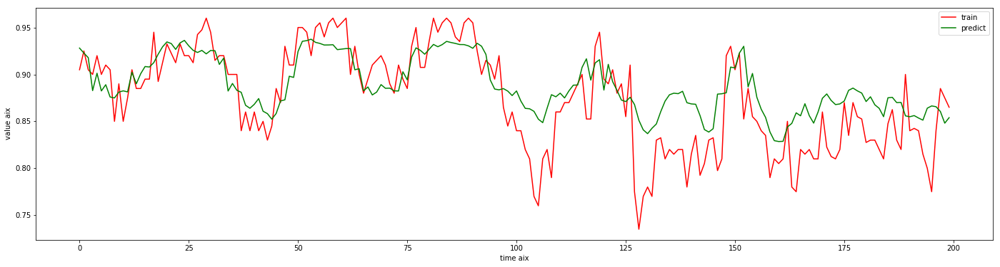

<Figure size 432x288 with 0 Axes>

In [156]:
plt.figure(figsize=(24,6))
plt.plot(testY[0:200],c='r',label="train")
plt.plot(testPredict[0:200],c='g',label="predict")
plt.xlabel("time aix")
plt.ylabel("value aix")
plt.legend() 
plt.show()
plt.savefig('reslut.jpg')